# Libraries

In [ ]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path
import SimpleITK as sitk
from scipy.ndimage import binary_erosion
import cv2

from glob import glob
from tqdm import tqdm

from skimage.segmentation import clear_border
from scipy.ndimage import binary_fill_holes, binary_closing, binary_dilation, binary_opening, binary_erosion
from skimage import measure, morphology
from skimage.segmentation import clear_border
from scipy.ndimage import median_filter

# Functions

In [ ]:
# Use the metadata to create the aligned true masks (coordinate system of the scan different from the one used in itk)
def make_mask(center, diam, z, width, height, spacing, origin):

    mask = np.zeros([height, width])

    v_center = (center-origin)/spacing
    v_diam = int(diam/spacing[0]+5)
    v_xmin = np.max([0,int(v_center[0]-v_diam)-5])
    v_xmax = np.min([width-1,int(v_center[0]+v_diam)+5])
    v_ymin = np.max([0,int(v_center[1]-v_diam)-5])
    v_ymax = np.min([height-1,int(v_center[1]+v_diam)+5])

    v_xrange = range(v_xmin, v_xmax+1)
    v_yrange = range(v_ymin, v_ymax+1)

    x_data = [x*spacing[0]+origin[0] for x in range(width)]
    y_data = [x*spacing[1]+origin[1] for x in range(height)]

    for v_x in v_xrange:
        for v_y in v_yrange:
            p_x = spacing[0]*v_x + origin[0]
            p_y = spacing[1]*v_y + origin[1]
            if np.linalg.norm(center-np.array([p_x, p_y, z])) <= diam:
                mask[int((p_y-origin[1])/spacing[1]), int((p_x-origin[0])/spacing[0])] = 1.0
    return mask

# Function to manage file name dynamically
def get_filename(file_list, case):
    for f in file_list:
        if case in f:
            return f
        
# Function to create more cases, data augementation
def modify_mask_around_nodule(df):

    for idx, row in df.iterrows():
        if row['class'] == 1:
            nodule_slice_index = row['sliceindex']

            has_nodule_above = df[(df['sliceindex'] == nodule_slice_index - 1) & (df['class'] == 1)].shape[0] > 0
            has_nodule_below = df[(df['sliceindex'] == nodule_slice_index + 1) & (df['class'] == 1)].shape[0] > 0

            if not has_nodule_above and not has_nodule_below:
                mask_nodule = np.copy(row['maskdata'])
                mask_nodule_modified = mask_nodule

                df.at[idx, 'maskdata'] = mask_nodule_modified.astype(np.uint8)
                df.at[idx, 'class'] = 1

                if idx - 1 >= 0:
                    df.at[idx - 1, 'maskdata'] = mask_nodule_modified.astype(np.uint8)

                    kernel = np.ones((7, 7), np.uint8)
                    eroded = cv2.erode(mask_nodule_modified, kernel, iterations=1)

                    df.at[idx - 1, 'maskdata'] = eroded
                    df.at[idx - 1, 'class'] = 1
                    df.at[idx - 1, 'label1'] = df.at[idx, 'label1']
                    df.at[idx - 1, 'label2'] = df.at[idx, 'label2']
                    df.at[idx - 1, 'label3'] = df.at[idx, 'label3']
                    df.at[idx - 1, 'label4'] = df.at[idx, 'label4']
                    df.at[idx - 1, 'label5'] = df.at[idx, 'label5']

                if idx + 1 < len(df):
                    df.at[idx + 1, 'maskdata'] = mask_nodule_modified.astype(np.uint8)

                    kernel = np.ones((7, 7), np.uint8)
                    eroded = cv2.erode(mask_nodule_modified, kernel, iterations=1)

                    df.at[idx + 1, 'maskdata'] = eroded
                    df.at[idx + 1, 'class'] = 1
                    df.at[idx + 1, 'label1'] = df.at[idx, 'label1']
                    df.at[idx + 1, 'label2'] = df.at[idx, 'label2']
                    df.at[idx + 1, 'label3'] = df.at[idx, 'label3']
                    df.at[idx + 1, 'label4'] = df.at[idx, 'label4']
                    df.at[idx + 1, 'label5'] = df.at[idx, 'label5']

# Create COCO format labels
def save_yolo_format_dataset(df, output_path):
    for index, row in df.iterrows():
        image_data = row['imagedata_filtered']
        class_label = row['class']

        # Naming convention for image and text files
        image_name = f"{row['seriesuid']}_slice{row['sliceindex']}.png"
        text_name = f"{row['seriesuid']}_slice{row['sliceindex']}.txt"

        # Create a new figure
        fig = plt.figure(figsize=(image_data.shape[1]/100, image_data.shape[0]/100), dpi=100)

        # Plot the image without interpolation
        plt.imshow(image_data, cmap='gray', interpolation='none')
        plt.axis('off')  # Turn off axes

        # Save the figure directly without any compression or data change
        plt.savefig(os.path.join(output_path, image_name), format='png', bbox_inches='tight', pad_inches=0)

        # Close the figure to release memory
        plt.close(fig)

        # Always create the text file, but conditionally write label information
        # Always create the text file, but conditionally write label information
        with open(os.path.join(output_path, text_name), 'w') as f:
            if class_label == 1:
                labels = [row[f'label{i}'] for i in range(1, 6) if not pd.isnull(row[f'label{i}'])]
                # Write class label and bounding box coordinates to the text file
                f.write(" ".join(map(str, labels)))
                print(f"Modified text file: {text_name}")
            else:
                print(f"Created empty text file: {text_name}")

# Data Preparation

## Axial Slices stored in df_slices dataframe

In [ ]:
file_path = "X/Data/subsets/subset0"
annotations_path = "X/Data/annotations.csv"


file_list = glob(file_path + "/*.mhd")

df_node = pd.read_csv(annotations_path)
df_node["file"] = df_node["seriesuid"].map(lambda file_name: get_filename(file_list, file_name))
df_node = df_node.dropna()

columns = ["seriesuid", "sliceindex", "imagedata", "maskdata", "class"]
data = []

# loop through all images
for img_file in tqdm(file_list):
    mini_df = df_node[df_node["file"]==img_file]
    if mini_df.shape[0] > 0:
        itk_img = sitk.ReadImage(img_file)
        img_array = sitk.GetArrayFromImage(itk_img)
        num_z, height, width = img_array.shape
        origin = np.array(itk_img.GetOrigin())
        spacing = np.array(itk_img.GetSpacing())

        for _, row in mini_df.iterrows():
            node_x, node_y, node_z = row["coordX"], row["coordY"], row["coordZ"]
            diam = row["diameter_mm"]
            center = np.array([node_x, node_y, node_z])
            v_center = np.rint((center-origin)/spacing)
            i_z = int(v_center[2])

            masks = np.zeros((num_z, height, width), dtype=np.uint8)
            mask = make_mask(center, diam, i_z*spacing[2]+origin[2], width, height, spacing, origin)
            masks[i_z] = mask

            classes = np.zeros(num_z, dtype=np.uint8)
            classes[i_z] = 1  

            for idx in range(num_z):
                data.append([row["seriesuid"], idx, img_array[idx], masks[idx], classes[idx]])


# Create a dataframe that contins the information of all patients (id, image slice index, image data, mask data, label)
df_slices = pd.DataFrame(data, columns=columns)
print(df_slices[df_slices["class"] == 1])
print("\n")

# Apply the function to modify the mask data
# modify_mask_around_nodule(df_slices)

# print(df_slices)

df_slices[df_slices["class"] == 1]

100%|██████████| 89/89 [01:35<00:00,  1.08s/it]


                                               seriesuid  sliceindex  \
33     1.3.6.1.4.1.14519.5.2.1.6279.6001.108197895896...          33   
187    1.3.6.1.4.1.14519.5.2.1.6279.6001.109002525524...          68   
337    1.3.6.1.4.1.14519.5.2.1.6279.6001.109002525524...          57   
628    1.3.6.1.4.1.14519.5.2.1.6279.6001.111172165674...         187   
1020   1.3.6.1.4.1.14519.5.2.1.6279.6001.124154461048...          41   
...                                                  ...         ...   
30351  1.3.6.1.4.1.14519.5.2.1.6279.6001.868211851413...         143   
30520  1.3.6.1.4.1.14519.5.2.1.6279.6001.898642529028...          66   
30751  1.3.6.1.4.1.14519.5.2.1.6279.6001.898642529028...          97   
30965  1.3.6.1.4.1.14519.5.2.1.6279.6001.905371958588...         111   
31062  1.3.6.1.4.1.14519.5.2.1.6279.6001.979083010707...          56   

                                               imagedata  \
33     [[-2048, -2048, -2048, -2048, -2048, -2048, -2...   
187    [[-3024,

,seriesuid,sliceindex,imagedata,maskdata,class
33,1.3.6.1.4.1.14519.5.2.1.6279.6001.108197895896...,33,"[[-2048, -2048, -2048, -2048, -2048, -2048, -2...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1
187,1.3.6.1.4.1.14519.5.2.1.6279.6001.109002525524...,68,"[[-3024, -3024, -3024, -3024, -3024, -3024, -3...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1
337,1.3.6.1.4.1.14519.5.2.1.6279.6001.109002525524...,57,"[[-3024, -3024, -3024, -3024, -3024, -3024, -3...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1
628,1.3.6.1.4.1.14519.5.2.1.6279.6001.111172165674...,187,"[[-3024, -3024, -3024, -3024, -3024, -3024, -3...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1
1020,1.3.6.1.4.1.14519.5.2.1.6279.6001.124154461048...,41,"[[-1024, -1024, -1024, -1024, -1024, -1024, -1...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1
...,...,...,...,...,...
30351,1.3.6.1.4.1.14519.5.2.1.6279.6001.868211851413...,143,"[[-2048, -2048, -2048, -2048, -2048, -2048, -2...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1
30520,1.3.6.1.4.1.14519.5.2.1.6279.6001.898642529028...,66,"[[-992, -999, -992, -997, -1000, -1000, -993, ...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1
30751,1.3.6.1.4.1.14519.5.2.1.6279.6001.898642529028...,97,"[[-981, -1000, -1000, -996, -1000, -1000, -989...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1
30965,1.3.6.1.4.1.14519.5.2.1.6279.6001.905371958588...,111,"[[-2048, -2048, -2048, -2048, -2048, -2048, -2...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1


## Create Labels

In [ ]:
# Initialize dataframe
columns = ["seriesuid", "nodule", "voxel_center_x", "voxel_center_y", "voxel_diameter"]
df_label = pd.DataFrame(columns=columns)

# Loop through image files
for img_file in tqdm(file_list):
    mini_df = df_node[df_node["file"]==img_file]  # Get nodules associated with file
    if mini_df.shape[0] > 0:
        itk_img = sitk.ReadImage(img_file)
        img_array = sitk.GetArrayFromImage(itk_img)
        num_z, height, width = img_array.shape
        origin = np.array(itk_img.GetOrigin())
        spacing = np.array(itk_img.GetSpacing())

        for _, row in mini_df.iterrows():
            node_x, node_y, node_z = row["coordX"], row["coordY"], row["coordZ"]
            diam = row["diameter_mm"]
            center = np.array([node_x, node_y, node_z])
            v_center = np.rint((center-origin)/spacing)
            i_z = int(v_center[2])

            voxel_center_x, voxel_center_y = v_center[:2]
            voxel_diameter = v_diam = int(diam/spacing[0]+5)

            # Initialize mask to zeros for all slices
            masks = np.zeros((num_z, height, width), dtype=np.uint8)
            mask = make_mask(center, diam, i_z*spacing[2]+origin[2], width, height, spacing, origin)
            masks[i_z] = mask

            # Initialize class to zeros for all slices
            classes = np.zeros(num_z, dtype=np.uint8)
            classes[i_z] = 1  # Set class to 1 only for the slice containing the nodule

            # Append data to dataframe
            df_label = df_label.append({
                "seriesuid": row["seriesuid"],
                "nodule": True,  # Since mini_df has nodules associated, mark it as True
                "voxel_center_x": voxel_center_x,
                "voxel_center_y": voxel_center_y,
                "voxel_diameter": voxel_diameter
            }, ignore_index=True)

# If no nodules are found for the file, add a row with 'nodule' as False
            if mini_df.empty:
                df_label = df_label.append({
                    "seriesuid": img_file,
                    "nodule": False,
                    "voxel_center_x": None,
                    "voxel_center_y": None,
                    "voxel_diameter": None
                }, ignore_index=True)

print(df_label)

# Initialize 'label' columns with NaN values
df_slices['label1'] = np.nan
df_slices['label2'] = np.nan
df_slices['label3'] = np.nan
df_slices['label4'] = np.nan
df_slices['label5'] = np.nan

# Find rows where class is 1
class_1_rows = df_slices[df_slices['class'] == 1].index

# Initialize iterator
iterator = iter(class_1_rows)

# Counter to keep track of the number of values appended
counter = 0

# Iterate using a while loop
while True:
    try:
        idx = next(iterator)
        # Get the corresponding row index in df
        df_idx = class_1_rows.get_loc(idx)
        # Check if the next row exists in df
        if df_idx + 1 < len(df_label) + 1:
            # Get voxel center and diameter from df
            voxel_center_x = df_label.at[df_idx, 'voxel_center_x']
            voxel_center_y = df_label.at[df_idx, 'voxel_center_y']
            voxel_diameter = df_label.at[df_idx, 'voxel_diameter']
            # Assign values to 'label' columns individually
            df_slices.at[idx, 'label1'] = 0
            df_slices.at[idx, 'label2'] = float(voxel_center_x)/512
            df_slices.at[idx, 'label3'] = float(voxel_center_y)/512
            df_slices.at[idx, 'label4'] = (float(voxel_diameter)/512)
            df_slices.at[idx, 'label5'] = (float(voxel_diameter)/512)
            # Increment counter
            counter += 1
            # Check if the next row has class 1 or if it's the last row
            if df_slices.at[idx + 1, 'class'] != 1 or df_idx + 1 == len(df_label) - 1:
                # Reset counter
                counter = 0
    except StopIteration:
        break

# Display the modified dataframe
df_slices[df_slices['class'] == 1]

  0%|          | 0/89 [00:00<?, ?it/s]C:\Users\USER\AppData\Local\Temp\ipykernel_10524\1427015727.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_label = df_label.append({
  2%|▏         | 2/89 [00:00<00:27,  3.19it/s]C:\Users\USER\AppData\Local\Temp\ipykernel_10524\1427015727.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_label = df_label.append({
C:\Users\USER\AppData\Local\Temp\ipykernel_10524\1427015727.py:35: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  df_label = df_label.append({
C:\Users\USER\AppData\Local\Temp\ipykernel_10524\1427015727.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas

                                             seriesuid nodule  voxel_center_x  \
0    1.3.6.1.4.1.14519.5.2.1.6279.6001.108197895896...   True           110.0   
1    1.3.6.1.4.1.14519.5.2.1.6279.6001.109002525524...   True           426.0   
2    1.3.6.1.4.1.14519.5.2.1.6279.6001.109002525524...   True           408.0   
3    1.3.6.1.4.1.14519.5.2.1.6279.6001.111172165674...   True           427.0   
4    1.3.6.1.4.1.14519.5.2.1.6279.6001.124154461048...   True           457.0   
..                                                 ...    ...             ...   
107  1.3.6.1.4.1.14519.5.2.1.6279.6001.868211851413...   True           214.0   
108  1.3.6.1.4.1.14519.5.2.1.6279.6001.898642529028...   True           177.0   
109  1.3.6.1.4.1.14519.5.2.1.6279.6001.898642529028...   True           400.0   
110  1.3.6.1.4.1.14519.5.2.1.6279.6001.905371958588...   True           390.0   
111  1.3.6.1.4.1.14519.5.2.1.6279.6001.979083010707...   True           100.0   

     voxel_center_y voxel_d

,seriesuid,sliceindex,imagedata,maskdata,class,label1,label2,label3,label4,label5
33,1.3.6.1.4.1.14519.5.2.1.6279.6001.108197895896...,33,"[[-2048, -2048, -2048, -2048, -2048, -2048, -2...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.214844,0.677734,0.025391,0.025391
187,1.3.6.1.4.1.14519.5.2.1.6279.6001.109002525524...,68,"[[-3024, -3024, -3024, -3024, -3024, -3024, -3...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.832031,0.558594,0.056641,0.056641
337,1.3.6.1.4.1.14519.5.2.1.6279.6001.109002525524...,57,"[[-3024, -3024, -3024, -3024, -3024, -3024, -3...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.796875,0.658203,0.023438,0.023438
628,1.3.6.1.4.1.14519.5.2.1.6279.6001.111172165674...,187,"[[-3024, -3024, -3024, -3024, -3024, -3024, -3...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.833984,0.685547,0.021484,0.021484
1020,1.3.6.1.4.1.14519.5.2.1.6279.6001.124154461048...,41,"[[-1024, -1024, -1024, -1024, -1024, -1024, -1...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.892578,0.447266,0.025391,0.025391
...,...,...,...,...,...,...,...,...,...,...
30351,1.3.6.1.4.1.14519.5.2.1.6279.6001.868211851413...,143,"[[-2048, -2048, -2048, -2048, -2048, -2048, -2...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.417969,0.677734,0.023438,0.023438
30520,1.3.6.1.4.1.14519.5.2.1.6279.6001.898642529028...,66,"[[-992, -999, -992, -997, -1000, -1000, -993, ...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.345703,0.253906,0.025391,0.025391
30751,1.3.6.1.4.1.14519.5.2.1.6279.6001.898642529028...,97,"[[-981, -1000, -1000, -996, -1000, -1000, -989...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.781250,0.330078,0.025391,0.025391
30965,1.3.6.1.4.1.14519.5.2.1.6279.6001.905371958588...,111,"[[-2048, -2048, -2048, -2048, -2048, -2048, -2...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.761719,0.625000,0.062500,0.062500


### Clean Duplicates

In [ ]:
df_slices.drop_duplicates(subset=['seriesuid', 'sliceindex','class'], inplace=True)
print("Shape of df_slices after removing duplicates:", df_slices.shape)

df_slices.sort_values(by='class', ascending=False, inplace=True)
df_slices.drop_duplicates(subset=['seriesuid', 'sliceindex'], inplace=True)
df_slices = df_slices.groupby('seriesuid').apply(lambda x: x.sort_values(by='sliceindex', ascending=True)).reset_index(drop=True)

df_slices[df_slices["class"] == 1]

Shape of df_slices after removing duplicates: (18492, 10)


,seriesuid,sliceindex,imagedata,maskdata,class,label1,label2,label3,label4,label5
33,1.3.6.1.4.1.14519.5.2.1.6279.6001.108197895896...,33,"[[-2048, -2048, -2048, -2048, -2048, -2048, -2...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.214844,0.677734,0.025391,0.025391
176,1.3.6.1.4.1.14519.5.2.1.6279.6001.109002525524...,57,"[[-3024, -3024, -3024, -3024, -3024, -3024, -3...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.796875,0.658203,0.023438,0.023438
187,1.3.6.1.4.1.14519.5.2.1.6279.6001.109002525524...,68,"[[-3024, -3024, -3024, -3024, -3024, -3024, -3...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.832031,0.558594,0.056641,0.056641
467,1.3.6.1.4.1.14519.5.2.1.6279.6001.111172165674...,187,"[[-3024, -3024, -3024, -3024, -3024, -3024, -3...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.833984,0.685547,0.021484,0.021484
859,1.3.6.1.4.1.14519.5.2.1.6279.6001.124154461048...,41,"[[-1024, -1024, -1024, -1024, -1024, -1024, -1...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.892578,0.447266,0.025391,0.025391
...,...,...,...,...,...,...,...,...,...,...
17846,1.3.6.1.4.1.14519.5.2.1.6279.6001.868211851413...,165,"[[-2048, -2048, -2048, -2048, -2048, -2048, -2...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.453125,0.632812,0.019531,0.019531
17993,1.3.6.1.4.1.14519.5.2.1.6279.6001.898642529028...,66,"[[-992, -999, -992, -997, -1000, -1000, -993, ...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.345703,0.253906,0.025391,0.025391
18024,1.3.6.1.4.1.14519.5.2.1.6279.6001.898642529028...,97,"[[-981, -1000, -1000, -996, -1000, -1000, -989...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.781250,0.330078,0.025391,0.025391
18238,1.3.6.1.4.1.14519.5.2.1.6279.6001.905371958588...,111,"[[-2048, -2048, -2048, -2048, -2048, -2048, -2...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.761719,0.625000,0.062500,0.062500


### Check class imbalance

In [ ]:
class0_df = df_slices[df_slices['class'] == 0].copy()

num_rows_to_drop = 17250 
num_rows_to_drop = min(num_rows_to_drop, len(class0_df))
rows_to_drop = np.random.choice(class0_df.index, num_rows_to_drop, replace=False)

class0_df = class0_df.drop(rows_to_drop)
class1_df = df_slices[df_slices['class'] == 1].copy()

filtered_df = pd.concat([class0_df, class1_df])
filtered_df.reset_index(drop=True, inplace=True)

filtered_df[filtered_df['class'] == 1]

,seriesuid,sliceindex,imagedata,maskdata,class,label1,label2,label3,label4,label5
1058,1.3.6.1.4.1.14519.5.2.1.6279.6001.108197895896...,33,"[[-2048, -2048, -2048, -2048, -2048, -2048, -2...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.214844,0.677734,0.025391,0.025391
1059,1.3.6.1.4.1.14519.5.2.1.6279.6001.109002525524...,57,"[[-3024, -3024, -3024, -3024, -3024, -3024, -3...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.796875,0.658203,0.023438,0.023438
1060,1.3.6.1.4.1.14519.5.2.1.6279.6001.109002525524...,68,"[[-3024, -3024, -3024, -3024, -3024, -3024, -3...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.832031,0.558594,0.056641,0.056641
1061,1.3.6.1.4.1.14519.5.2.1.6279.6001.111172165674...,187,"[[-3024, -3024, -3024, -3024, -3024, -3024, -3...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.833984,0.685547,0.021484,0.021484
1062,1.3.6.1.4.1.14519.5.2.1.6279.6001.124154461048...,41,"[[-1024, -1024, -1024, -1024, -1024, -1024, -1...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.892578,0.447266,0.025391,0.025391
...,...,...,...,...,...,...,...,...,...,...
1164,1.3.6.1.4.1.14519.5.2.1.6279.6001.868211851413...,165,"[[-2048, -2048, -2048, -2048, -2048, -2048, -2...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.453125,0.632812,0.019531,0.019531
1165,1.3.6.1.4.1.14519.5.2.1.6279.6001.898642529028...,66,"[[-992, -999, -992, -997, -1000, -1000, -993, ...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.345703,0.253906,0.025391,0.025391
1166,1.3.6.1.4.1.14519.5.2.1.6279.6001.898642529028...,97,"[[-981, -1000, -1000, -996, -1000, -1000, -989...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.781250,0.330078,0.025391,0.025391
1167,1.3.6.1.4.1.14519.5.2.1.6279.6001.905371958588...,111,"[[-2048, -2048, -2048, -2048, -2048, -2048, -2...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.761719,0.625000,0.062500,0.062500


In [ ]:
class_column_name = 'class'

def class_ratio(df, class_column):
    class_counts = df[class_column].value_counts()
    if 1 in class_counts.index and 0 in class_counts.index:
        ratio = class_counts[1] / class_counts[0]
        return ratio
    else:
        return None

ratio = class_ratio(filtered_df, class_column_name)
if ratio is not None:
    print("Ratio of rows with class 1 to class 0:", ratio)
else:
    print("Class 1 or Class 0 missing in the dataframe.")

Ratio of rows with class 1 to class 0: 0.10491493383742911


### Run if you want to apply nodule neighboring in the z axis data augmentation

In [ ]:
# modify_mask_around_nodule(df_slices)

df_slices[df_slices['class'] == 1]

,seriesuid,sliceindex,imagedata,maskdata,class,label1,label2,label3,label4,label5
33,1.3.6.1.4.1.14519.5.2.1.6279.6001.108197895896...,33,"[[-2048, -2048, -2048, -2048, -2048, -2048, -2...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.214844,0.677734,0.025391,0.025391
176,1.3.6.1.4.1.14519.5.2.1.6279.6001.109002525524...,57,"[[-3024, -3024, -3024, -3024, -3024, -3024, -3...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.796875,0.658203,0.023438,0.023438
187,1.3.6.1.4.1.14519.5.2.1.6279.6001.109002525524...,68,"[[-3024, -3024, -3024, -3024, -3024, -3024, -3...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.832031,0.558594,0.056641,0.056641
467,1.3.6.1.4.1.14519.5.2.1.6279.6001.111172165674...,187,"[[-3024, -3024, -3024, -3024, -3024, -3024, -3...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.833984,0.685547,0.021484,0.021484
859,1.3.6.1.4.1.14519.5.2.1.6279.6001.124154461048...,41,"[[-1024, -1024, -1024, -1024, -1024, -1024, -1...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.892578,0.447266,0.025391,0.025391
...,...,...,...,...,...,...,...,...,...,...
17846,1.3.6.1.4.1.14519.5.2.1.6279.6001.868211851413...,165,"[[-2048, -2048, -2048, -2048, -2048, -2048, -2...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.453125,0.632812,0.019531,0.019531
17993,1.3.6.1.4.1.14519.5.2.1.6279.6001.898642529028...,66,"[[-992, -999, -992, -997, -1000, -1000, -993, ...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.345703,0.253906,0.025391,0.025391
18024,1.3.6.1.4.1.14519.5.2.1.6279.6001.898642529028...,97,"[[-981, -1000, -1000, -996, -1000, -1000, -989...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.781250,0.330078,0.025391,0.025391
18238,1.3.6.1.4.1.14519.5.2.1.6279.6001.905371958588...,111,"[[-2048, -2048, -2048, -2048, -2048, -2048, -2...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.761719,0.625000,0.062500,0.062500


### Ploting and Visualization of data

In [ ]:
'''
# Plot images alone
def plot_images(df_slices, slice_index):
    plt.figure(figsize=(8, 8))
    plt.imshow(df_slices.iloc[slice_index]['imagedata'], cmap='gray')
    plt.title("Image")
    plt.axis('off')
    plt.show()

# Plot masks alone
def plot_masks(df_slices, slice_index):
    plt.figure(figsize=(8, 8))
    plt.imshow(df_slices.iloc[slice_index]['maskdata'], cmap='jet')
    plt.title("Mask")
    plt.axis('off')
    plt.show()

# Plot both images and masks together
def plot_images_with_masks(df_slices, slice_index):
    plt.figure(figsize=(8, 8))
    plt.imshow(df_slices.iloc[slice_index]['imagedata'], cmap='gray')
    plt.imshow(df_slices.iloc[slice_index]['maskdata'], alpha=0.5, cmap='jet')
    plt.title("Image with Mask")
    plt.axis('off')
    plt.show()

# Plotting example
slice_index = 49  # Change this index to visualize different slices
plot_images(df_slices, slice_index)
plot_masks(df_slices, slice_index)
plot_images_with_masks(df_slices, slice_index)

'''

# Plot images alone
def plot_images(df_slices, slice_index):
    plt.figure(figsize=(8, 8))
    plt.imshow(df_slices.iloc[slice_index]['imagedata'], cmap='gray')
    print(df_slices.iloc[slice_index]['seriesuid'])
    plt.title("Image")
    plt.axis('off')
    plt.show()

# Plot both images and masks together
def plot_images_with_masks(df_slices, slice_index):
    plt.figure(figsize=(8, 8))
    plt.imshow(df_slices.iloc[slice_index]['imagedata'], cmap='gray')
    plt.imshow(df_slices.iloc[slice_index]['maskdata'], alpha=0.1, cmap='gray')
    plt.title("Image with Mask")
    plt.axis('off')
    plt.show()

# Plot images with class = 1
def plot_images_with_class(df_slices):
    class_1_slices = df_slices[df_slices['class'] == 1]
    for idx, row in class_1_slices.iterrows():
        # plot_images(df_slices, idx)
        plot_images_with_masks(df_slices, idx)

        # Calculate coordinates and size of the square
        x_center = df_slices.iloc[idx]['label2']
        y_center = df_slices.iloc[idx]['label3']
        side_length = df_slices.iloc[idx]['label4']

        # Calculate corner coordinates
        x_min = int(512*x_center - 512*side_length / 2)
        x_max = int(512*x_center + 512*side_length / 2)
        y_min = int(512*y_center - 512*side_length / 2)
        y_max = int(512*y_center + 512*side_length / 2)

        # Create square plot
        plt.figure(figsize=(8, 8))
        plt.imshow(df_slices.iloc[idx]['imagedata'], cmap='gray')
        plt.title("IMAGE")

        # Plot square
        plt.plot([x_min, x_min], [y_min, y_max], color='red')  # Vertical line left
        plt.plot([x_max, x_max], [y_min, y_max], color='red')  # Vertical line right
        plt.plot([x_min, x_max], [y_min, y_min], color='red')  # Horizontal line bottom
        plt.plot([x_min, x_max], [y_max, y_max], color='red')  # Horizontal line top

        plt.axis('off')
        plt.show()


# Call the function to plot images with class = 1
# plot_images_with_class(filtered_df)

# Data Enhancement:
    1. Lung Segmentation
    2. Denoising
    3. Images Shape Normalization
    4. Pixel Values Normalization [0,1] or [-1,1]

## 1. Lung Segmentation

### Function defintions

In [ ]:
def imshow(img):
  return cv2.imshow(img)

def normalize_intensity(image, scale_min=0, scale_max=255):
  # Calculate the minimum and maximum of the image
  img_min = np.min(image)
  img_max = np.max(image)

  # Normalize the image
  normalized_image = (image - img_min) / (img_max - img_min) * (scale_max - scale_min) + scale_min

  return normalized_image

def process_slices(image, axis_index, func):
    """
    Process all the slices of a 3D image along a specified axis using a given function.

    Parameters:
        image (numpy.ndarray): The input 3D image.
        axis_index (int): The index of the axis along which to iterate (0 for x, 1 for y, 2 for z).
        func (callable): The function to apply to each slice.

    Returns:
        numpy.ndarray: The modified image.
    """
    # Ensure axis_index is within valid range
    if axis_index < 0 or axis_index > 2:
        raise ValueError("Axis index must be 0, 1, or 2.")

    # Iterate over slices along the specified axis
    for idx in range(image.shape[axis_index]):
        # Extract the slice along the specified axis
        if axis_index == 0:
            slice_ = image[idx, :, :]
        elif axis_index == 1:
            slice_ = image[:, idx, :]
        else:
            slice_ = image[:, :, idx]

        # Apply the function to the slice
        modified_slice = func(slice_)

        # Update the slice in the original image
        if axis_index == 0:
            image[idx, :, :] = modified_slice
        elif axis_index == 1:
            image[:, idx, :] = modified_slice
        else:
            image[:, :, idx] = modified_slice

    return image

def unwanted_object_filter(img: np.ndarray) -> np.ndarray:
  closed = binary_closing(img, morphology.disk((3)))

  # Label connected components
  labels = measure.label(closed)
  properties = measure.regionprops(labels)

  # Sort regions by area and keep the two largest
  detected_objects = sorted(properties, key=lambda x: x.area, reverse=True)

  # Filter out the relevant sizes
  area_th = 50
  detected_objects = [obj for obj in detected_objects if obj.area > area_th]

  # Case when more than 4 detected object
  if len(detected_objects) >= 4:
    detected_objects = detected_objects[:4]

    # 4th largest object is significantly smaller then the 3rd
    if detected_objects[2].area * 0.1 > (detected_objects[3].area):
        detected_objects = detected_objects[:3]

    # 3rd largest object is significantly smaller then the 2nd
    if detected_objects[1].area * 0.5 > (detected_objects[2].area):
      detected_objects = detected_objects[:2]

  # Case when there is only 3 detected objects
  elif len(detected_objects) == 3:
    # 3rd largest object is significantly smaller then the 2nd
    if detected_objects[1].area * 0.1 > (detected_objects[2].area):
      detected_objects = detected_objects[:2]

  # Create an empty image to hold the result
  filtered_image = np.zeros_like(img, dtype=np.uint8)

  # Fill in the regions of the two largest objects
  for prop in detected_objects:
      filtered_image[labels == prop.label] = 255

  return filtered_image


def closing(img):
  closed = binary_closing(img, morphology.disk((5)))
  return closed


def dilate(img):
  dilated = binary_dilation(img, morphology.disk((3)))
  return dilated

def erosion(img):
  eroded = binary_erosion(img, morphology.disk((3)))
  return eroded

def opening(img):
  opened = binary_opening(img, morphology.disk((3)))
  return opened


def gaussian_blur(img):
  kernel_size = 5
  blur = img.copy()

  needs_0_shift = img.min() < 0
  if needs_0_shift:
    blur = blur + img.min()

  blur = cv2.GaussianBlur(img, (kernel_size, kernel_size), 0) # apply blur

  if needs_0_shift:
    blur = blur - img.min()

  return blur

def median_blur(img, ksize=5):
  return cv2.medianBlur(img, ksize=ksize)


air_th = -1200 # HU th specified by findings in the sources
lung_th = -500 # HU th specified by findings in the sources

def lung_mask(img: np.ndarray, verbose=True):
  """
  Extraction function for lung ROI (2D and 3D)

  - thresholding using HU for air filled organs
  - clearing info outside of the subject body
  - dilation and filling of the ROI (lung area)
  """
  nothing = None
  # 3D
  if len(img.shape) == 3:

    # Denoising
    if verbose:
      # print(f"[PROC] - DENOISING")
      nothing = None
    denoised = np.vectorize(median_blur, signature="(n,m)->(n,m)")(img)

    # Thresholding
    if verbose:
      print(f"[PROC] - THRESHOLDNG")
    bin = denoised <= lung_th
    bin[bin < air_th] = air_th

    th = bin.astype(np.uint8) * 255 # normalizing to 0 and 255 values (unsigned 8-bit int) !NOTE!: this might be an unneded line

    if verbose:
      print(f"[PROC] - CLEARING BORDER ON Z-AXIS")
    th = np.vectorize(clear_border, signature="(n,m)->(n,m)")(th) # remove border

    if verbose:
      print(f"[PROC] - OBJECT FILTERING ON Z-AXIS")
    th = np.vectorize(unwanted_object_filter, signature="(n,m)->(n,m)")(th) # remove small objects

    # th = np.vectorize(closing, signature="(n,m)->(n,m)")(th) # remove small holes and edge smoothing

    for i in range(2):
      if verbose:
        print(f"[PROC] - FILLING HOLES on AXIS-{i}")
      if i: # Don't run on Z axis
        th = process_slices(th, i, binary_fill_holes)


      if verbose:
        print(f"[PROC] - CLOSING on AXIS-{i}")
      th = process_slices(th, i, closing)




  # 2D NOTE: WIP
  elif len(img.shape) == 2:

    # Denoising
    if verbose:
      # print(f"[PROC] - DENOISING-Modified")
      nothing = None
    denoised = img # median_blur(img)

    # Thresholding
    if verbose:
      # print(f"[PROC] - THRESHOLDNG")
      nothing = None
    bin = denoised <= lung_th
    bin[bin < air_th] = air_th

    # Normalize
    th = bin.astype(np.uint8) * 255 # normalizing to 0 and 255 values (unsigned 8-bit int) !NOTE!: this might be an unneded line

    # Clear border
    if verbose:
      # print(f"[PROC] - CLEARING BORDER ON Z-AXIS")
      nothing = None
    th = clear_border(th) # remove border

    if verbose:
      # print(f"[PROC] - OBJECT FILTERING ON Z-AXIS")
      nothing = None
    th = unwanted_object_filter(th) # remove small objects

    for i in range(2):
      if verbose:
        # print(f"[PROC] - FILLING HOLES on AXIS-{i}")
        nothing = None
      if i: # Don't run on Z axis
        th = binary_fill_holes(th)

      if verbose:
        # print(f"[PROC] - CLOSING on AXIS-{i}")
        nothing = None
      th = closing(th)

  return th


def lung_mask_by_uid(uid):
  return lung_mask(img_by_uid(uid),)

### Visualize lung segmentation

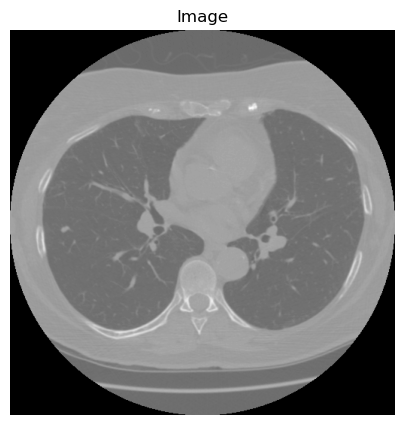

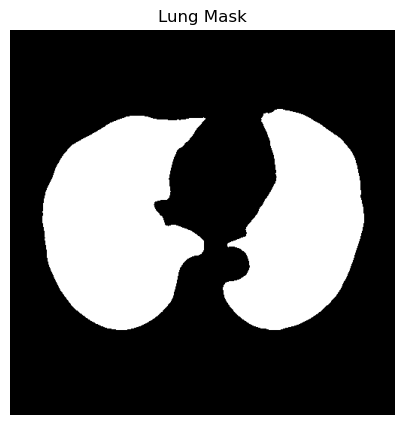

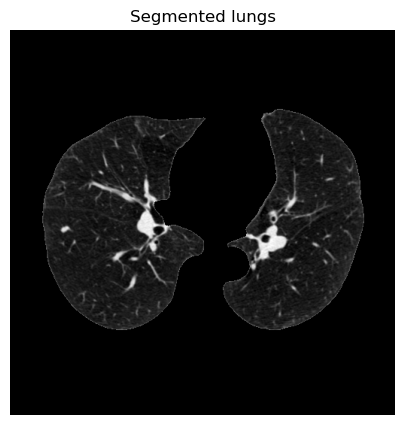

In [ ]:
test_image = filtered_df.iloc[1100]['imagedata']
segmented = lung_mask(test_image)

seg = test_image * segmented.astype(bool)
seg[segmented == False] = seg.min() # Setting unsegmented voxels to minimum value for masking

plt.figure(figsize=(5, 5))
plt.imshow(test_image, cmap='gray')
plt.title("Image")
plt.axis('off')
plt.show()

plt.figure(figsize=(5, 5))
plt.imshow(segmented, cmap='gray')
plt.title("Lung Mask")
plt.axis('off')
plt.show()

plt.figure(figsize=(5, 5))
plt.imshow(seg, cmap='gray')
plt.title("Segmented lungs")
plt.axis('off')
plt.show()

### Apply to filtered_df

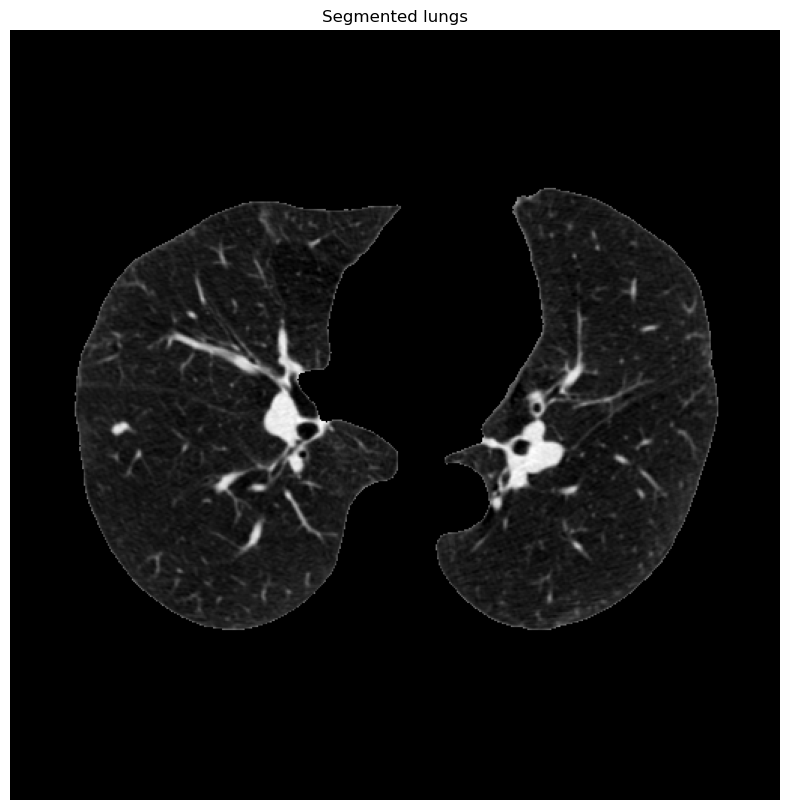

In [ ]:
# Create a new DataFrame to store segmented lung images
segmented_df = filtered_df.copy()

# Initialize the 'lungimage' column in the new DataFrame
segmented_df['lungimage'] = None

# Loop through the DataFrame and apply lung segmentation
for i in range(len(segmented_df)):
    test_image = segmented_df.iloc[i]['imagedata']
    segmented = lung_mask(test_image)

    seg = test_image * segmented.astype(bool)
    seg[segmented == False] = seg.min()  # Set unsegmented voxels to minimum value

    segmented_df.at[i, 'lungimage'] = seg  # Store the segmented image

# Verify the results
test_lung = segmented_df.iloc[1100]['lungimage']

plt.figure(figsize=(10, 10))
plt.imshow(test_lung, cmap='gray')
plt.title("Segmented lungs")
plt.axis('off')
plt.show()


In [ ]:
segmented_df

,seriesuid,sliceindex,imagedata,maskdata,class,label1,label2,label3,label4,label5,lungimage
0,1.3.6.1.4.1.14519.5.2.1.6279.6001.108197895896...,19,"[[-2048, -2048, -2048, -2048, -2048, -2048, -2...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",0,NaN,NaN,NaN,NaN,NaN,"[[-965, -965, -965, -965, -965, -965, -965, -9..."
1,1.3.6.1.4.1.14519.5.2.1.6279.6001.108197895896...,26,"[[-2048, -2048, -2048, -2048, -2048, -2048, -2...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",0,NaN,NaN,NaN,NaN,NaN,"[[-962, -962, -962, -962, -962, -962, -962, -9..."
2,1.3.6.1.4.1.14519.5.2.1.6279.6001.108197895896...,31,"[[-2048, -2048, -2048, -2048, -2048, -2048, -2...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",0,NaN,NaN,NaN,NaN,NaN,"[[-975, -975, -975, -975, -975, -975, -975, -9..."
3,1.3.6.1.4.1.14519.5.2.1.6279.6001.108197895896...,85,"[[-2048, -2048, -2048, -2048, -2048, -2048, -2...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",0,NaN,NaN,NaN,NaN,NaN,"[[-1024, -1024, -1024, -1024, -1024, -1024, -1..."
4,1.3.6.1.4.1.14519.5.2.1.6279.6001.108197895896...,91,"[[-2048, -2048, -2048, -2048, -2048, -2048, -2...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",0,NaN,NaN,NaN,NaN,NaN,"[[-1024, -1024, -1024, -1024, -1024, -1024, -1..."
...,...,...,...,...,...,...,...,...,...,...,...
1164,1.3.6.1.4.1.14519.5.2.1.6279.6001.868211851413...,165,"[[-2048, -2048, -2048, -2048, -2048, -2048, -2...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.453125,0.632812,0.019531,0.019531,"[[-987, -987, -987, -987, -987, -987, -987, -9..."
1165,1.3.6.1.4.1.14519.5.2.1.6279.6001.898642529028...,66,"[[-992, -999, -992, -997, -1000, -1000, -993, ...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.345703,0.253906,0.025391,0.025391,"[[-1000, -1000, -1000, -1000, -1000, -1000, -1..."
1166,1.3.6.1.4.1.14519.5.2.1.6279.6001.898642529028...,97,"[[-981, -1000, -1000, -996, -1000, -1000, -989...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.781250,0.330078,0.025391,0.025391,"[[-1000, -1000, -1000, -1000, -1000, -1000, -1..."
1167,1.3.6.1.4.1.14519.5.2.1.6279.6001.905371958588...,111,"[[-2048, -2048, -2048, -2048, -2048, -2048, -2...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",1,0.0,0.761719,0.625000,0.062500,0.062500,"[[-1024, -1024, -1024, -1024, -1024, -1024, -1..."


## 2. Denoising

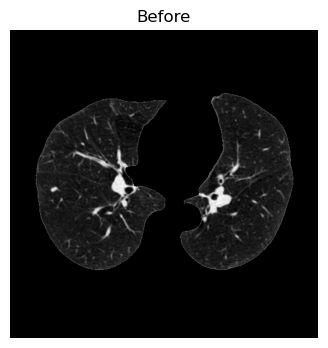

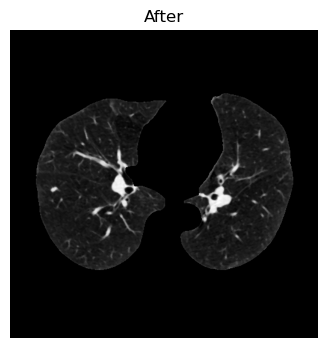

In [ ]:
# Show an image before filtering
plt.figure(figsize=(4,4))
test_lung = segmented_df.iloc[1100]['lungimage']
plt.imshow(test_lung, cmap = 'gray')
plt.title("Before")
plt.axis('off')
plt.show()

#apply median filter to all the dataframe (not masks though of course)
segmented_df["imagedata_filtered"] = segmented_df["lungimage"].apply(lambda x: cv2.medianBlur(x, 3))
test_lung_filtered = segmented_df.iloc[1100]["imagedata_filtered"]

# And after
plt.figure(figsize=(4,4))
plt.imshow(test_lung_filtered, cmap='gray')
plt.title("After")
plt.axis('off')
plt.show()

## 3. Images Shape Normalization - Already Normalized

In [ ]:
# for i in range(len(df_slices["imagedata"])):
    # print("Image", i+1, "shape:", df_slices["imagedata"][i].shape)


# image_counts = df_slices.groupby('seriesuid').size()
# print("Number of images for each seriesuid:")
# print(image_counts)

## 4. Pixel Values Normalization [0,1] or [-1,1]

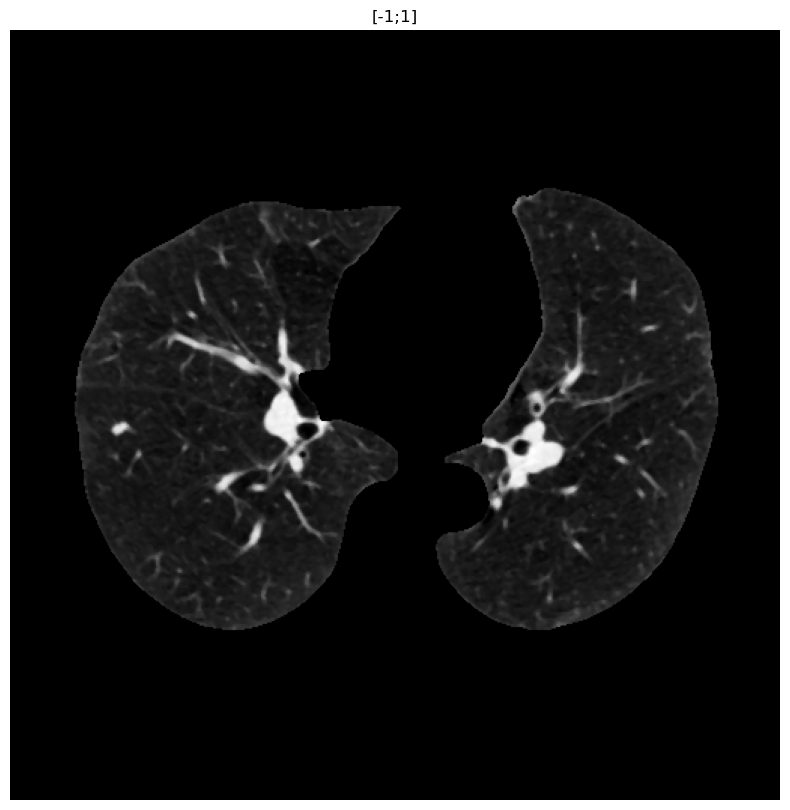

In [ ]:
def rescale_intensity(image):
    """
    Rescale the pixel values of the image to lie between -1 and 1.

    Parameters:
        image (np.ndarray): The input image.

    Returns:
        np.ndarray: The rescaled image.
    """
    min_val = np.min(image)
    max_val = np.max(image)
    scaled_image = 2 * ((image - min_val) / (max_val - min_val)) - 1
    return scaled_image

# Apply rescaling to the segmented lungs image
segmented_lungs_rescaled = rescale_intensity(test_lung_filtered)
segmented_df["imagedata_rescaled"] = segmented_df["imagedata_filtered"].apply(lambda x: rescale_intensity(x))

test_scaled = segmented_df.iloc[1100]["imagedata_rescaled"]

plt.figure(figsize=(10, 10))
plt.imshow(segmented_lungs_rescaled, cmap='gray')
plt.title("[-1;1]")
plt.axis('off')
plt.show()

In [ ]:
filtered_df[filtered_df['class'] == 1].shape

(111, 10)

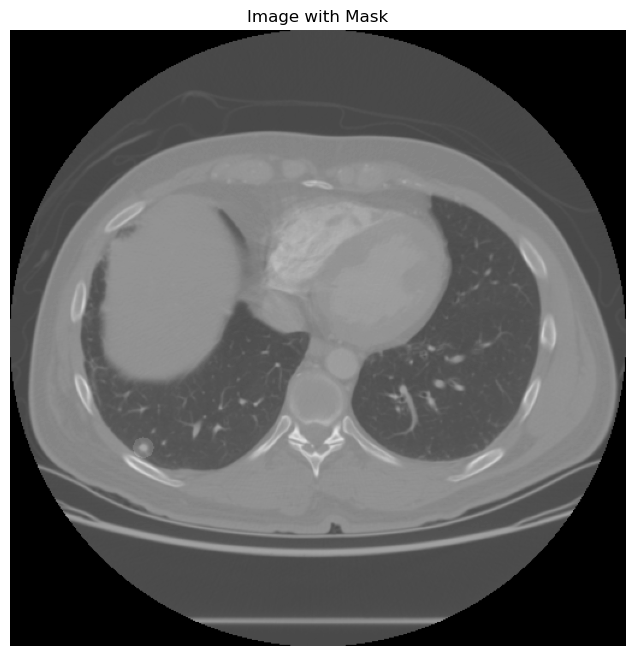

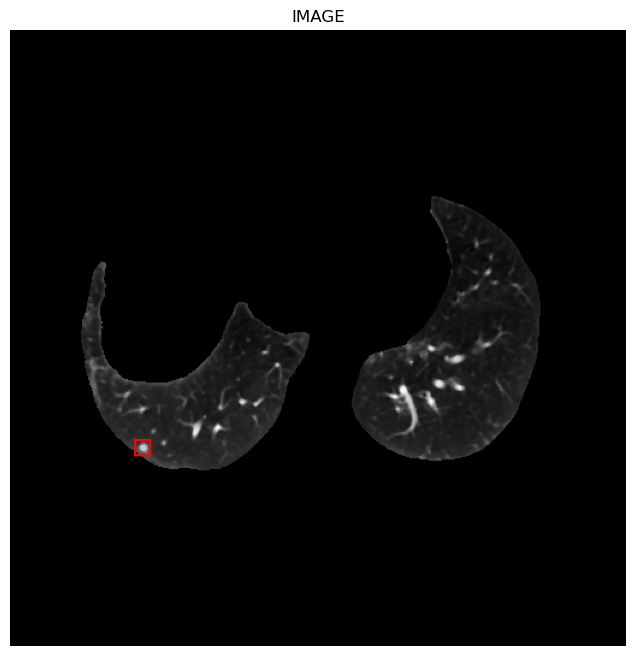

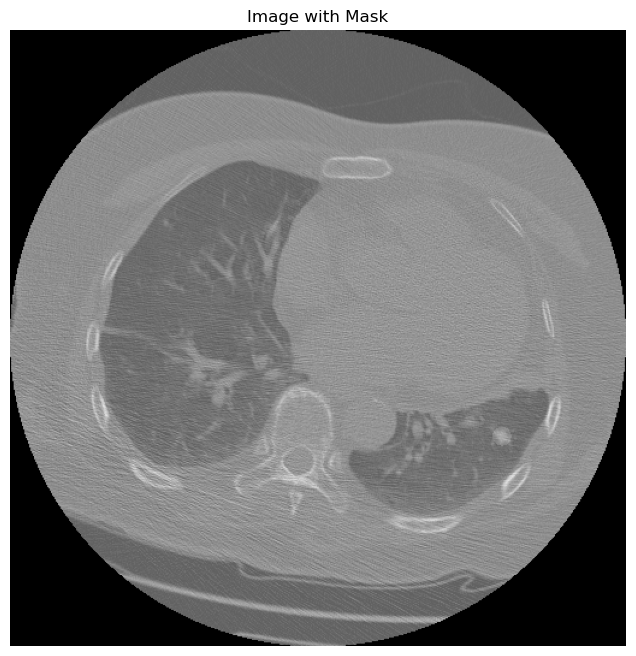

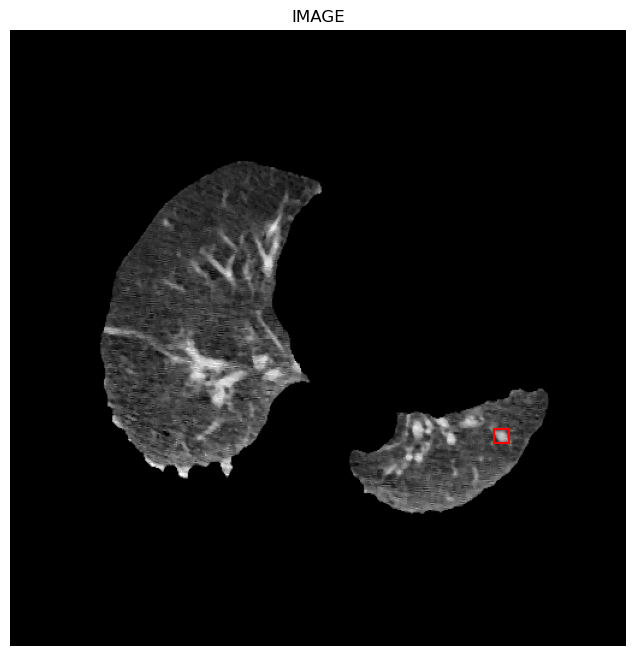

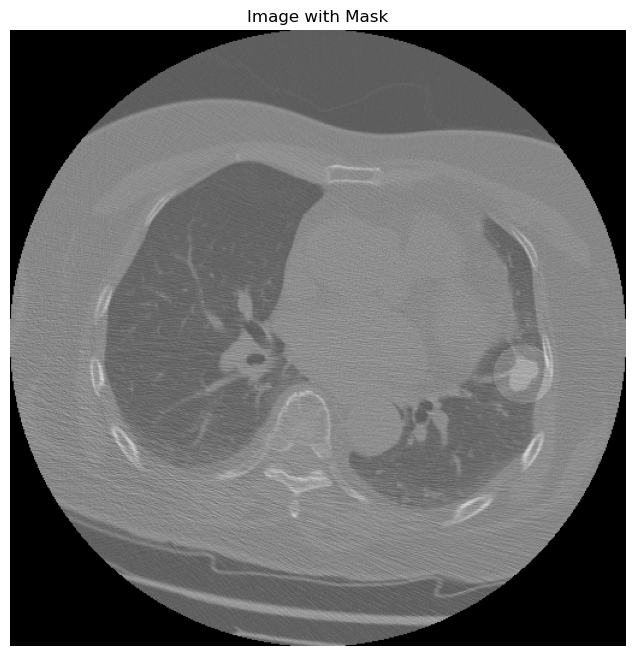

...

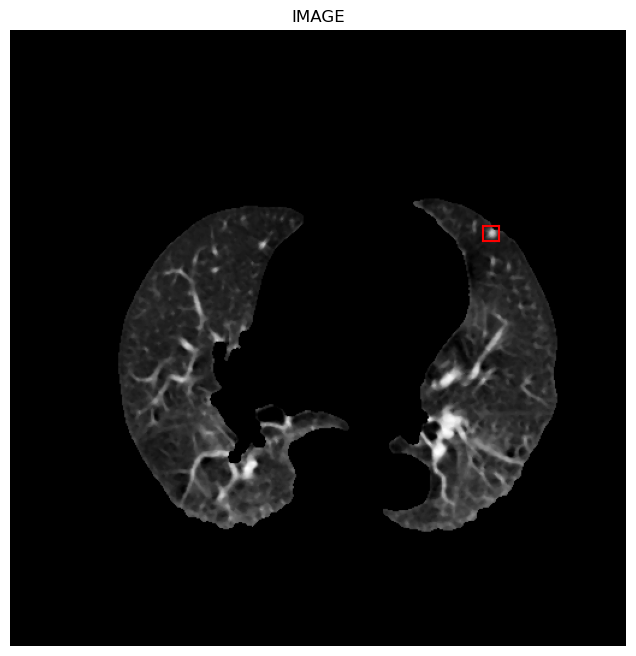

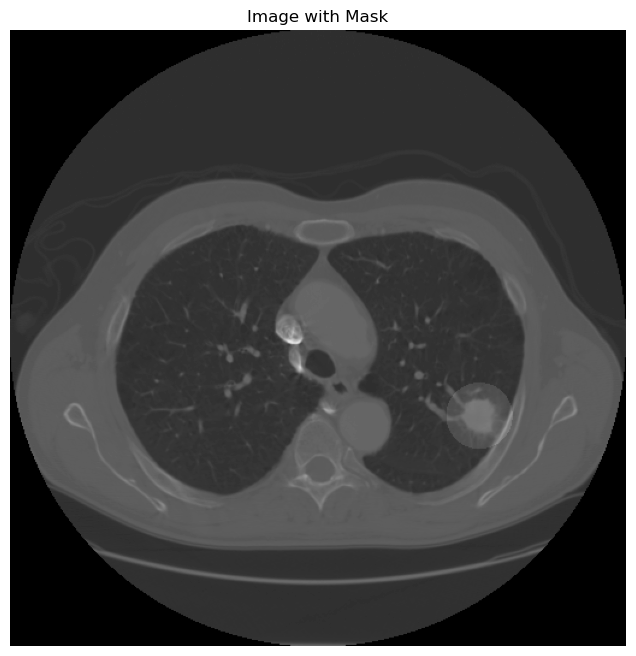

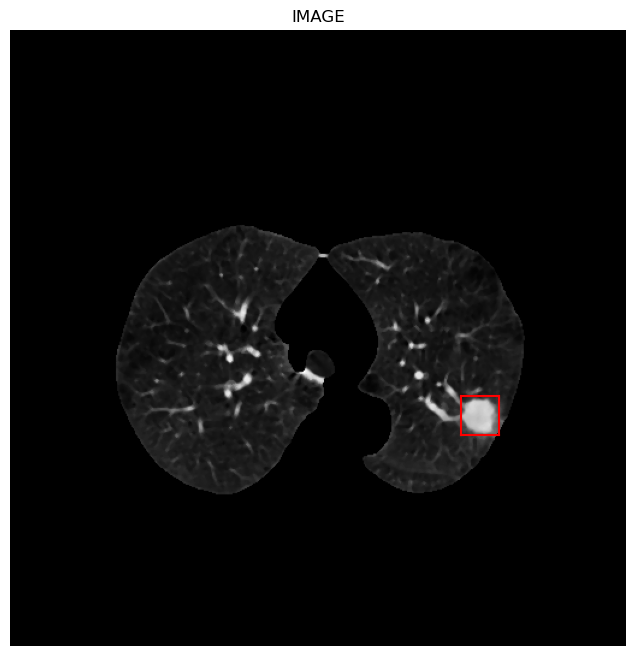

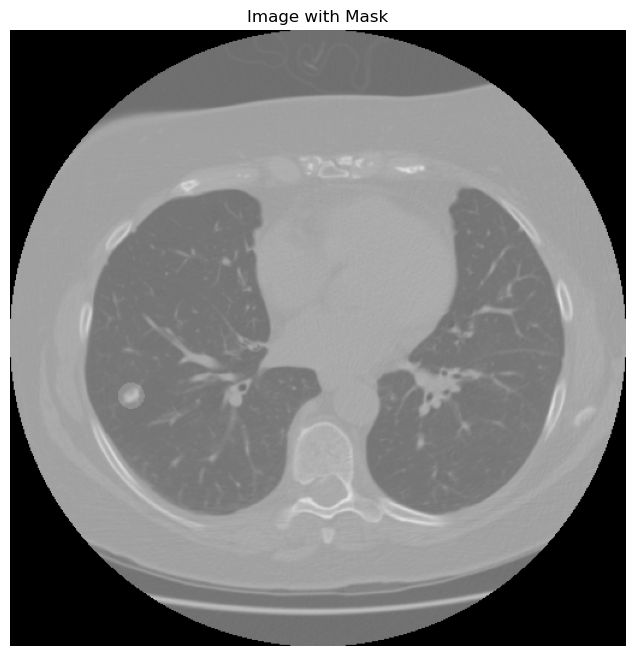

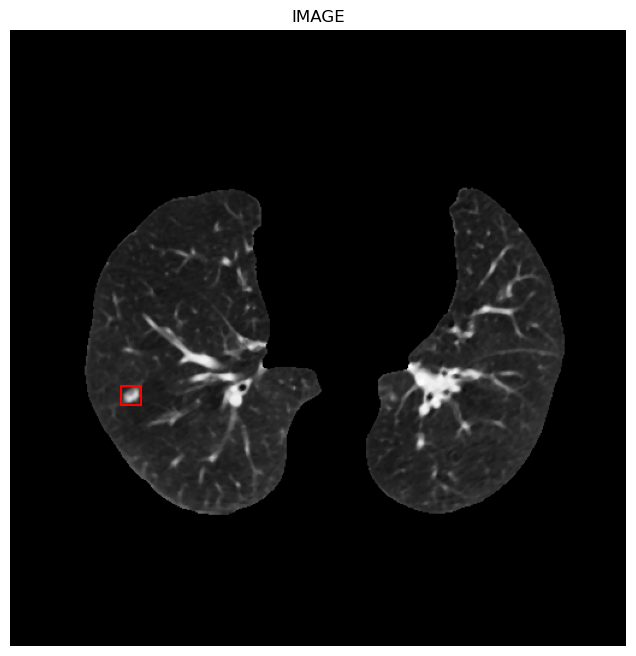

In [ ]:
# Plot images with class = 1
def plot_images_with_class(df):
    class_1_slices = df[df['class'] == 1]
    for idx, row in class_1_slices.iterrows():
        # plot_images(df_slices, idx)
        plot_images_with_masks(df, idx)

        # Calculate coordinates and size of the square
        x_center = df.iloc[idx]['label2']
        y_center = df.iloc[idx]['label3']
        side_length = df.iloc[idx]['label4']

        # Calculate corner coordinates
        x_min = int(512*x_center - 512*side_length / 2)
        x_max = int(512*x_center + 512*side_length / 2)
        y_min = int(512*y_center - 512*side_length / 2)
        y_max = int(512*y_center + 512*side_length / 2)

        # Create square plot
        plt.figure(figsize=(8, 8))
        plt.imshow(df.iloc[idx]['imagedata_rescaled'], cmap='gray')
        plt.title("IMAGE")

        # Plot square
        plt.plot([x_min, x_min], [y_min, y_max], color='red')  # Vertical line left
        plt.plot([x_max, x_max], [y_min, y_max], color='red')  # Vertical line right
        plt.plot([x_min, x_max], [y_min, y_min], color='red')  # Horizontal line bottom
        plt.plot([x_min, x_max], [y_max, y_max], color='red')  # Horizontal line top

        plt.axis('off')
        plt.show()


# Call the function to plot images with class = 1
plot_images_with_class(segmented_df)

# Create Labels & Images (THIS WILL SAVE TO HARD DISK)

## Bounding Boxes on NoduleIMGs --> Create txt label files (YOLO format)
### Empty txt files fo no nodule images

In [ ]:
output_path = "X/Data/Test"

save_yolo_format_dataset(filtered_df, output_path)

Created empty text file: 1.3.6.1.4.1.14519.5.2.1.6279.6001.294188507421106424248264912111_slice9.txt
Created empty text file: 1.3.6.1.4.1.14519.5.2.1.6279.6001.294188507421106424248264912111_slice13.txt
Created empty text file: 1.3.6.1.4.1.14519.5.2.1.6279.6001.294188507421106424248264912111_slice31.txt
Created empty text file: 1.3.6.1.4.1.14519.5.2.1.6279.6001.294188507421106424248264912111_slice34.txt
Created empty text file: 1.3.6.1.4.1.14519.5.2.1.6279.6001.294188507421106424248264912111_slice37.txt
Created empty text file: 1.3.6.1.4.1.14519.5.2.1.6279.6001.294188507421106424248264912111_slice48.txt
Created empty text file: 1.3.6.1.4.1.14519.5.2.1.6279.6001.294188507421106424248264912111_slice54.txt
Created empty text file: 1.3.6.1.4.1.14519.5.2.1.6279.6001.294188507421106424248264912111_slice91.txt
Created empty text file: 1.3.6.1.4.1.14519.5.2.1.6279.6001.294188507421106424248264912111_slice127.txt
Created empty text file: 1.3.6.1.4.1.14519.5.2.1.6279.6001.29418850742110642424826